In [1]:
%load_ext zipline
%load_ext watermark
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import pandas as pd
import numpy as np
from collections import OrderedDict
import pytz

# необходимые функции zipline
from zipline.api import (order, record, symbol, set_benchmark, order_target_percent, get_open_orders, order_target, 
                        schedule_function, date_rules, time_rules, order_percent, symbols)

# комиссии
from zipline.finance import commission

# выбор календаря по которому происходит торговля
from trading_calendars.always_open import AlwaysOpenCalendar

import zipline

# графика
import matplotlib.pyplot as plt
from matplotlib import style
import matplotlib.dates as mdates
import matplotlib.ticker as ticker

# работа с временем
from datetime import datetime, date

# aинансовые данные
from yahoofinancials import YahooFinancials

# ignore warnings
import warnings

# отчёт
import pyfolio as pf

# import helper functions 
import qf_helper_functions as qf

import pypfopt
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models
from pypfopt import expected_returns

import pylab

from tqdm import tqdm

In [3]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [16, 4]
plt.rcParams['figure.dpi'] = 200
warnings.simplefilter(action='ignore', category=FutureWarning)

In [4]:
def download_csv_data(ticker, start_date, end_date, freq, path):
    
    yahoo_financials = YahooFinancials(ticker)

    df = yahoo_financials.get_historical_price_data(start_date, end_date, freq)
    df = pd.DataFrame(df[ticker]['prices']).drop(['date'], axis=1) \
            .rename(columns={'formatted_date':'date'}) \
            .loc[:, ['date','open','high','low','close', 'adjclose', 'volume']] \
            .set_index('date')
    df.index = pd.to_datetime(df.index)
    df['dividend'] = 0
    df['split'] = 1

    # save data to csv for later ingestion
    df.to_csv(path, header=True, index=True)

    # plot the time series
    df.close.plot(title='{} prices --- {}:{}'.format(ticker, start_date, end_date), color='green');

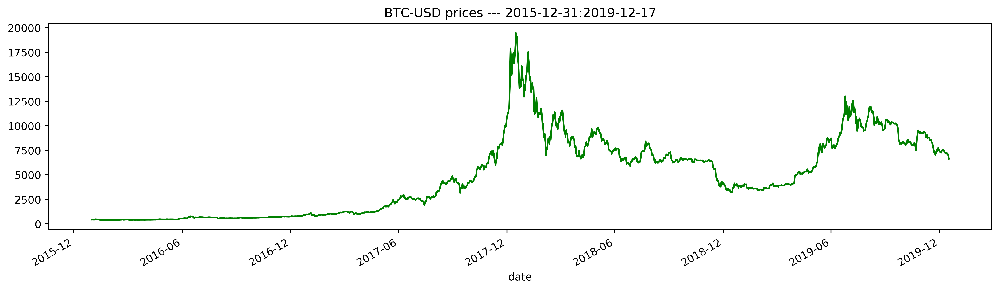

In [5]:
download_csv_data(ticker='BTC-USD', 
                  start_date='2015-12-31', 
                  end_date='2019-12-17', 
                  freq='daily', 
                  path='data/BTC.csv')

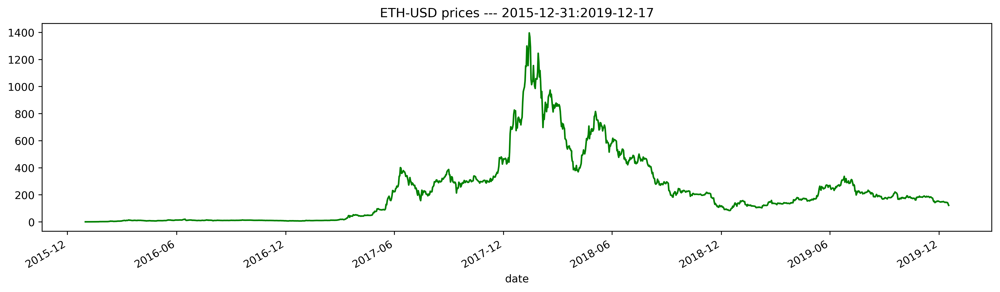

In [6]:
download_csv_data(ticker='ETH-USD', 
                  start_date='2015-12-31', 
                  end_date='2019-12-17', 
                  freq='daily', 
                  path='data/ETH.csv')

In [7]:
# Список финансовых инструментов в портфеле
TIKERS = ['BTC', 'ETH']

# Данные которые будут использоваться в дальнейшем
COLUMNS = ['open', 'high', 'low', 'close']

In [8]:
data = OrderedDict()

for tiker in TIKERS:
    data[tiker] = pd.read_csv("data/{}.csv".format(tiker), index_col=0, parse_dates=['date'])
    data[tiker] = data[tiker][COLUMNS]
    data[tiker] = data[tiker].resample("1d").mean()
    data[tiker].fillna(method="ffill", inplace=True)
    print(data[tiker].tail())

                   open         high          low        close
date                                                          
2019-12-13  7244.662109  7293.560547  7227.122559  7269.684570
2019-12-14  7268.902832  7308.836426  7097.208984  7124.673828
2019-12-15  7124.239746  7181.075684  6924.375977  7152.301758
2019-12-16  7153.663086  7171.168945  6903.682617  6932.480469
2019-12-17  6931.315430  6964.075195  6587.974121  6640.515137
                  open        high         low       close
date                                                      
2019-12-13  145.655685  145.857101  143.746521  144.944748
2019-12-14  144.953415  145.529083  142.434555  142.869232
2019-12-15  142.864990  143.925354  139.426956  143.114990
2019-12-16  143.139526  143.224854  132.456665  133.614029
2019-12-17  133.647186  134.011536  121.395081  122.603889


In [9]:
panel = pd.Panel(data)
panel.minor_axis = COLUMNS
panel.major_axis = panel.major_axis.tz_localize(pytz.utc)
print(panel)

<class 'pandas.core.panel.Panel'>
Dimensions: 2 (items) x 1448 (major_axis) x 4 (minor_axis)
Items axis: BTC to ETH
Major_axis axis: 2015-12-31 00:00:00+00:00 to 2019-12-17 00:00:00+00:00
Minor_axis axis: open to close


In [10]:
WEIGHTS = [[0.8, 0], [0.55, 0.25]]
ASSETS_START = [date(2017, 1, 2)]
COMMISSION = 0.0007

In [11]:
def initialize(context):
    
    context.set_commission(commission.PerDollar(cost=COMMISSION))
    
    set_benchmark(symbol('BTC'))
    
    context.tikers = TIKERS
    context.assets = [context.symbol(symbol) for symbol in context.tikers]
    
    context.weights = WEIGHTS
    context.n_assets = len(context.assets)
    
    context.window = 1
    
    context.stage = 0
    
    context.assets_start = ASSETS_START
    
    context.rebalance_period = 90
    context.time = 0

In [12]:
def asset_chek(context, day, n):
    
    # Проверка начала закупки
    if day == context.assets_start[n]:
        context.stage = n + 1
        context.time = 0

In [13]:
def start_buying_check(context, data):
    
    prices = data.history(context.assets, fields='price', bar_count=context.window, frequency='1d')
    day = prices.index[0].date()
    
    for i in range(0, context.n_assets - 1):
        asset_chek(context, day, i) 

In [14]:
def handle_data(context, data):
    
    start_buying_check(context, data)
    
    # Закупка и ребаллансировка
    if context.time == 0 or (context.time % context.rebalance_period == 0):
        
        
        # submit orders
        for i, asset in enumerate(context.assets):
            order_target_percent(asset, context.weights[context.stage][i])
            
    
    context.time += 1

In [15]:
perf = zipline.run_algorithm(start=datetime(2015, 12, 31, 0, 0, 0, 0, pytz.utc),
                              end=datetime(2019, 12, 17, 0, 0, 0, 0, pytz.utc),
                              initialize=initialize,
                              capital_base=10000000,
                              trading_calendar=AlwaysOpenCalendar(),
                              handle_data=handle_data,
                              data=panel)

In [16]:
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(perf)

# Создание отчета стратегии

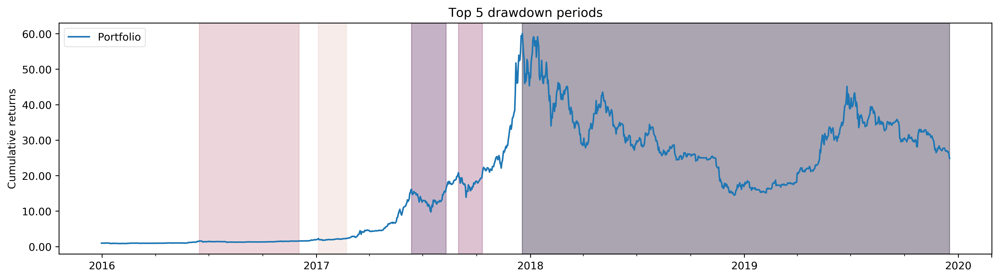

In [17]:
pf.plot_drawdown_periods(returns, top=5)
plt.show()

Start date,2015-12-31
End date,2019-12-17
Total months,68
,Backtest
Annual return,75.0%
Cumulative returns,2389.3%
Annual volatility,54.0%
Sharpe ratio,1.31
Calmar ratio,0.99
Stability,0.73
Max drawdown,-75.8%


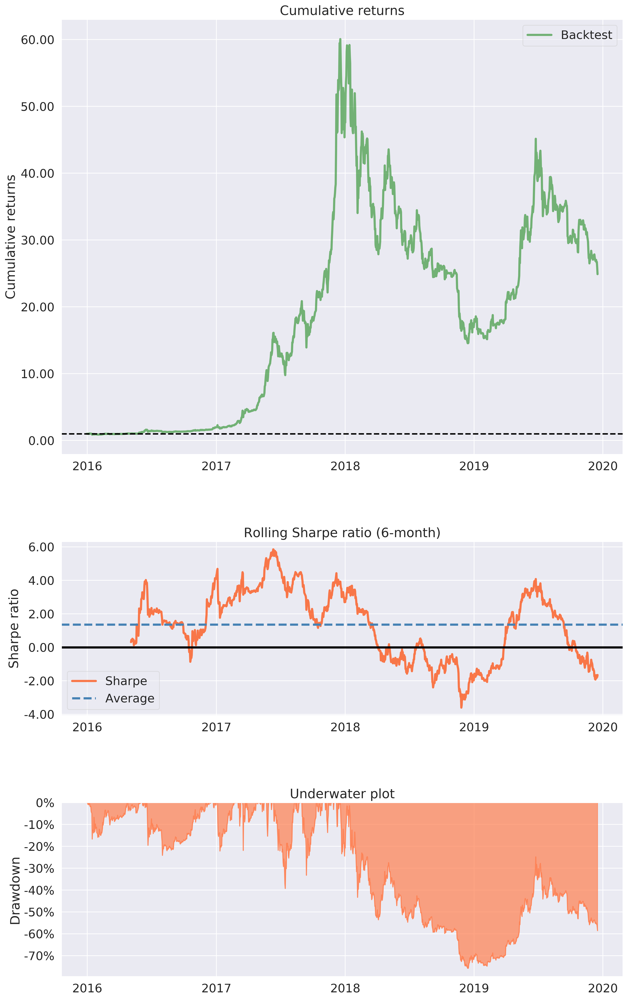

In [18]:
pf.create_simple_tear_sheet(returns)

In [19]:
qf.get_performance_summary(returns)

annual_volatility      0.540441
annualized_returns     0.749696
cumulative_returns    23.892656
max_drawdown          -0.757701
sharpe_ratio           1.305295
sortino_ratio          2.003829
dtype: float64

In [20]:
pf.create_simple_tear_sheet(returns, positions, transactions, live_start_date='2017-01-01')

Start date,2015-12-31
End date,2019-12-17
Total months,68
,Backtest
Annual return,75.0%
Cumulative returns,2389.3%
Annual volatility,54.0%
Sharpe ratio,1.31
Calmar ratio,0.99
Stability,0.73
Max drawdown,-75.8%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,75.77,2017-12-18,2018-12-15,NaT,NaN
1,39.29,2017-06-12,2017-07-15,2017-08-10,44
2,33.23,2017-08-31,2017-09-13,2017-10-11,30
3,24.14,2016-06-15,2016-08-01,2016-12-02,123
4,22.16,2017-01-04,2017-01-11,2017-02-21,35


Stress Events,mean,min,max
New Normal,0.28%,-20.70%,20.46%


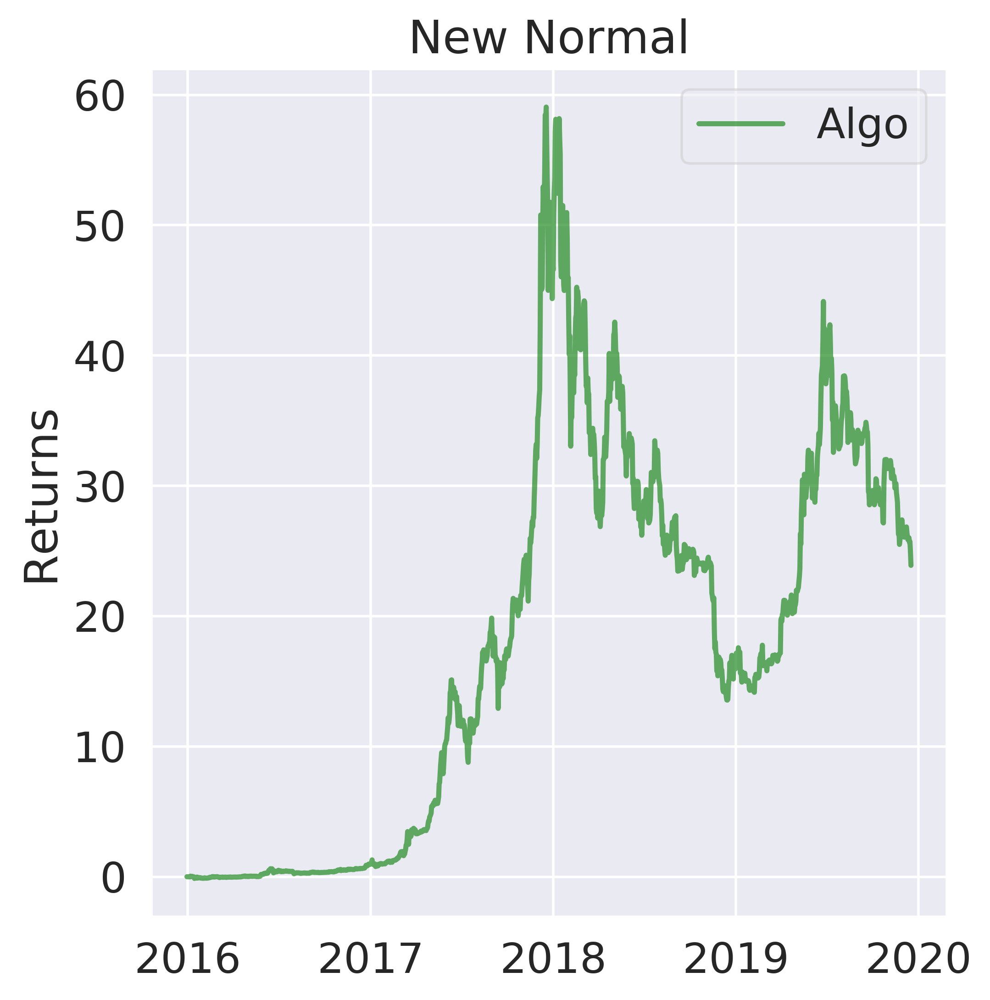

In [21]:
pf.create_full_tear_sheet(returns)

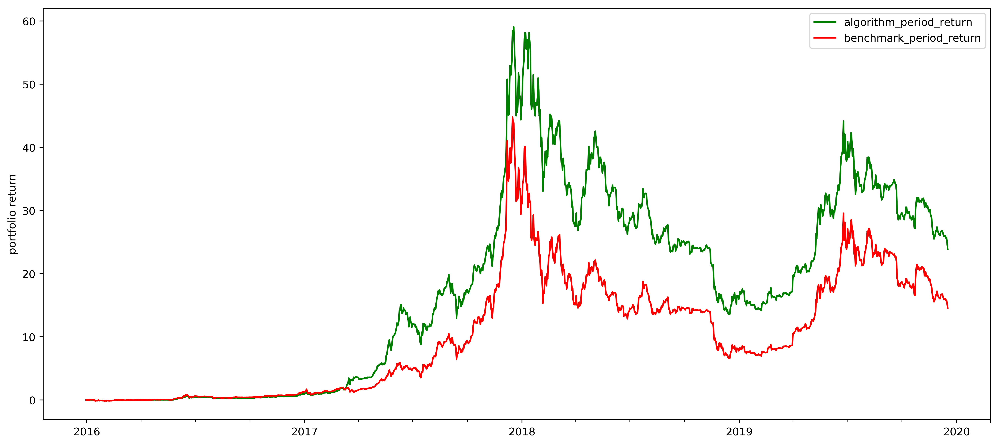

Final portfolio return: 2389.27%
Final benchmark return: 1459.26%


In [22]:
fig, ax = plt.subplots(figsize=[16, 7])

# portfolio value
perf.algorithm_period_return.plot(color='g')
perf.benchmark_period_return.plot(color='r')

ax.set_ylabel('portfolio return')

plt.legend()
plt.show()

print('Final portfolio return: {}%'.format(np.round(perf.algorithm_period_return[-1] * 100, 2)))
print('Final benchmark return: {}%'.format(np.round(perf.benchmark_period_return[-1] * 100, 2)))

In [23]:
paradigm = perf.portfolio_value
paradigm = paradigm / 100000

In [24]:
paradigm = paradigm.to_frame(name="close")

In [25]:
paradigm.tail()

,close
2019-12-13 00:00:00+00:00,2701.424728
2019-12-14 00:00:00+00:00,2665.070143
2019-12-15 00:00:00+00:00,2671.385690
2019-12-16 00:00:00+00:00,2590.341501
2019-12-17 00:00:00+00:00,2489.265567


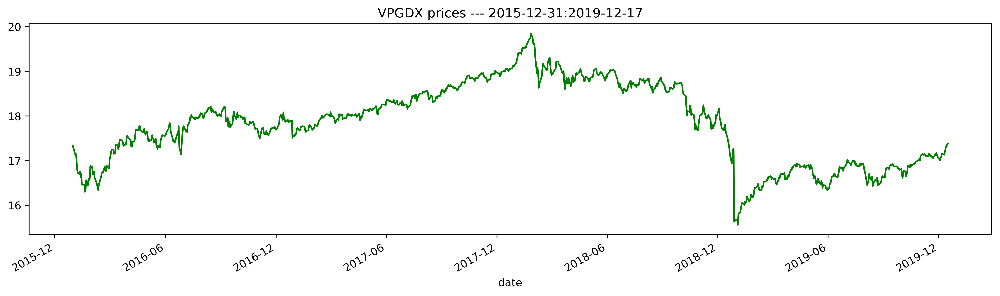

In [26]:
download_csv_data(ticker='VPGDX', 
                  start_date='2015-12-31', 
                  end_date='2019-12-17', 
                  freq='daily', 
                  path='data/VPGDX.csv')

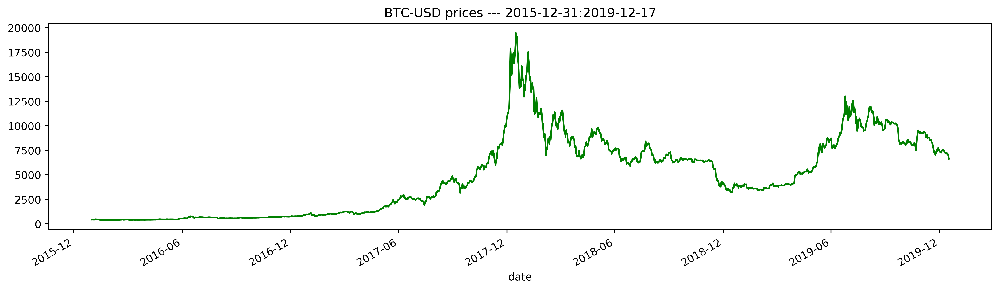

In [27]:
download_csv_data(ticker='BTC-USD', 
                  start_date='2015-12-31', 
                  end_date='2019-12-17', 
                  freq='daily', 
                  path='data/BTC.csv')

In [28]:
RETURN = []

# Симуляция с 1% BTC

In [29]:
# Список финансовых инструментов в портфеле
TIKERS = ['VPGDX', 'BTC']

# Данные которые будут использоваться в дальнейшем
COLUMNS = ['open', 'close', 'adjclose']

In [30]:
data = OrderedDict()

for tiker in TIKERS:
    data[tiker] = pd.read_csv("data/{}.csv".format(tiker), index_col=0, parse_dates=['date'])
    data[tiker] = data[tiker][COLUMNS]
    data[tiker] = data[tiker].resample("1d").mean()
    data[tiker].fillna(method="ffill", inplace=True)
    print(data[tiker].tail())

                 open      close   adjclose
date                                       
2019-12-12  17.250000  17.250000  16.760828
2019-12-13  17.309999  17.309999  16.819126
2019-12-14  17.309999  17.309999  16.819126
2019-12-15  17.309999  17.309999  16.819126
2019-12-16  17.379999  17.379999  16.887140
                   open        close     adjclose
date                                             
2019-12-13  7244.662109  7269.684570  7269.684570
2019-12-14  7268.902832  7124.673828  7124.673828
2019-12-15  7124.239746  7152.301758  7152.301758
2019-12-16  7153.663086  6932.480469  6932.480469
2019-12-17  6931.315430  6640.515137  6640.515137


In [31]:
for tiker in TIKERS:
    data[tiker]['close'] = data[tiker]['adjclose']
    data[tiker]['open'] = data[tiker]['adjclose']
    del data[tiker]['adjclose']
    print(data[tiker].tail())
COLUMNS = ['open', 'close']

                 open      close
date                            
2019-12-12  16.760828  16.760828
2019-12-13  16.819126  16.819126
2019-12-14  16.819126  16.819126
2019-12-15  16.819126  16.819126
2019-12-16  16.887140  16.887140
                   open        close
date                                
2019-12-13  7269.684570  7269.684570
2019-12-14  7124.673828  7124.673828
2019-12-15  7152.301758  7152.301758
2019-12-16  6932.480469  6932.480469
2019-12-17  6640.515137  6640.515137


In [32]:
panel = pd.Panel(data)
panel.minor_axis = COLUMNS
panel.major_axis = panel.major_axis.tz_localize(pytz.utc)
print(panel)

<class 'pandas.core.panel.Panel'>
Dimensions: 2 (items) x 1448 (major_axis) x 2 (minor_axis)
Items axis: VPGDX to BTC
Major_axis axis: 2015-12-31 00:00:00+00:00 to 2019-12-17 00:00:00+00:00
Minor_axis axis: open to close


In [33]:
WEIGHTS = [0.99, 0.01]
COMMISSION = 0.0007

In [34]:
def initialize(context):
    
    context.set_commission(commission.PerDollar(cost=COMMISSION))
    
    set_benchmark(symbol('VPGDX'))
    
    context.tikers = TIKERS
    context.assets = [context.symbol(symbol) for symbol in context.tikers]
    
    context.weights = WEIGHTS
    context.n_assets = len(context.assets)
    
    context.window = 1
    
    context.rebalance_period = 1000000
    context.time = 0

In [35]:
def handle_data(context, data):
    
    # Закупка и ребаллансировка
    if context.time == 0 or (context.time % context.rebalance_period == 0):
        
        
        # submit orders
        for i, asset in enumerate(context.assets):
            order_target_percent(asset, context.weights[i])
            
    
    context.time += 1

In [36]:
perf = zipline.run_algorithm(start=datetime(2015, 12, 31, 0, 0, 0, 0, pytz.utc),
                              end=datetime(2019, 12, 17, 0, 0, 0, 0, pytz.utc),
                              initialize=initialize,
                              capital_base=10000000,
                              handle_data=handle_data,
                              data=panel)

In [37]:
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(perf)

In [38]:
pf.create_simple_tear_sheet(returns, positions, transactions, live_start_date='2018-01-01')

Start date,2015-12-31
End date,2019-12-17
Total months,47
,Backtest
Annual return,10.2%
Cumulative returns,47.1%
Annual volatility,11.2%
Sharpe ratio,0.93
Calmar ratio,0.38
Stability,0.76
Max drawdown,-26.6%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,26.59,2017-12-18,2018-12-24,NaT,NaN
1,4.61,2015-12-31,2016-01-20,2016-03-01,44
2,3.50,2016-06-23,2016-06-27,2016-07-01,7
3,3.02,2016-09-07,2016-11-04,2016-12-07,66
4,2.66,2017-08-31,2017-09-13,2017-10-04,25


Stress Events,mean,min,max
New Normal,0.04%,-4.78%,5.56%


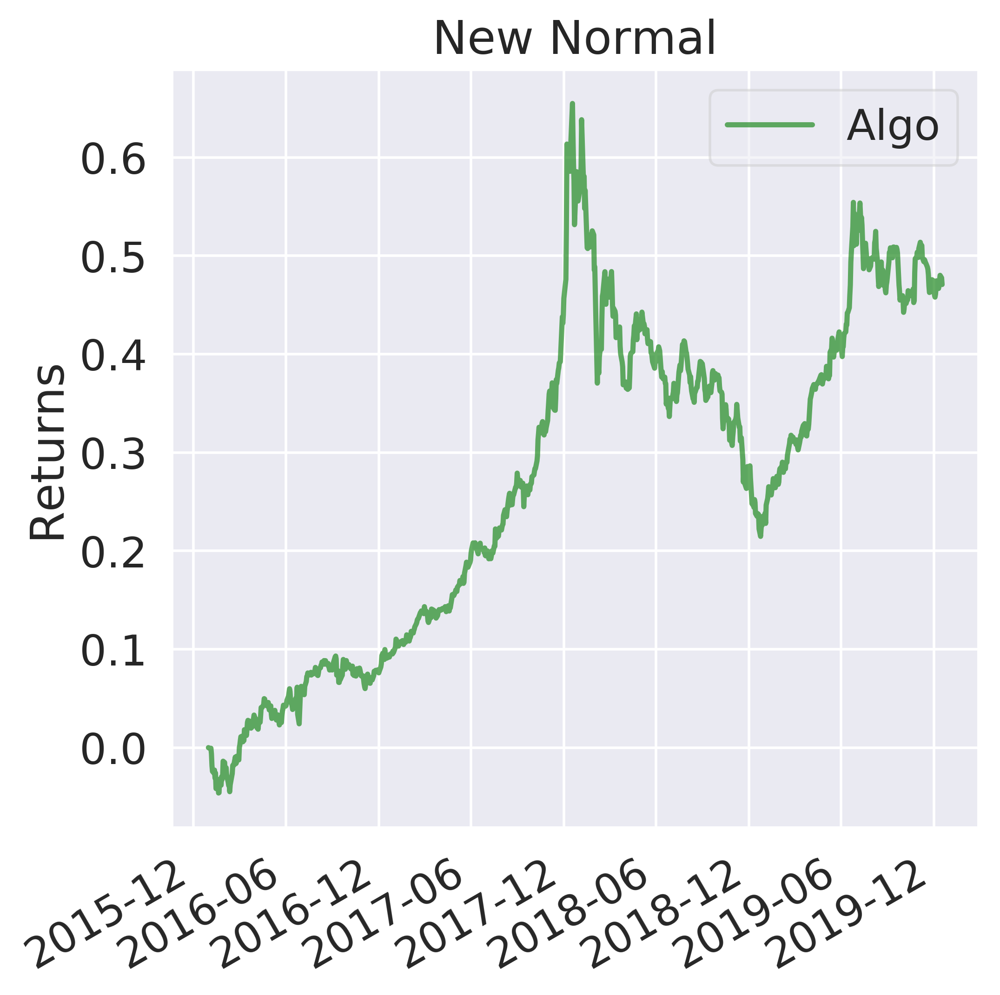

In [39]:
pf.create_full_tear_sheet(returns)

In [40]:
qf.get_performance_summary(returns)

annual_volatility     0.111604
annualized_returns    0.102325
cumulative_returns    0.470822
max_drawdown         -0.265934
sharpe_ratio          0.928839
sortino_ratio         1.341434
dtype: float64

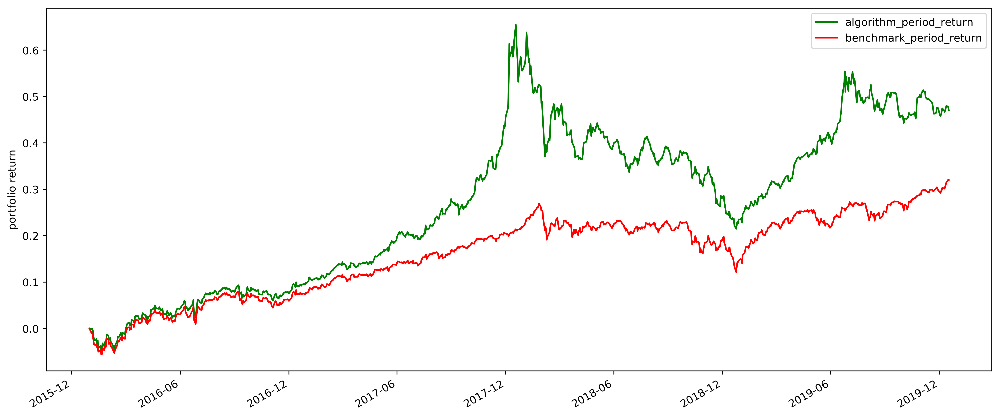

Final portfolio return: 47.08%
Final benchmark return: 32.03%


In [41]:
fig, ax = plt.subplots(figsize=[16, 7])

# portfolio value
perf.algorithm_period_return.plot(color='g')
perf.benchmark_period_return.plot(color='r')

ax.set_ylabel('portfolio return')

plt.legend()
plt.show()

print('Final portfolio return: {}%'.format(np.round(perf.algorithm_period_return[-1] * 100, 2)))
print('Final benchmark return: {}%'.format(np.round(perf.benchmark_period_return[-1] * 100, 2)))

In [42]:
(perf.portfolio_value/100000).tail()

2019-12-11 00:00:00+00:00    146.991681
2019-12-12 00:00:00+00:00    147.502591
2019-12-13 00:00:00+00:00    148.015442
2019-12-16 00:00:00+00:00    147.759589
2019-12-17 00:00:00+00:00    147.082229
Name: portfolio_value, dtype: float64

In [43]:
bitcoin1 = perf.algorithm_period_return

In [44]:
RETURN.append(np.round(bitcoin1[-1] * 100, 2))

In [45]:
RETURN

[47.079999999999998]

In [46]:
bitcoinPortfolio = 1000 * (1 + bitcoin1)

bitcoinPortfolio = bitcoinPortfolio.rename('Bitcoin 1% Target') 

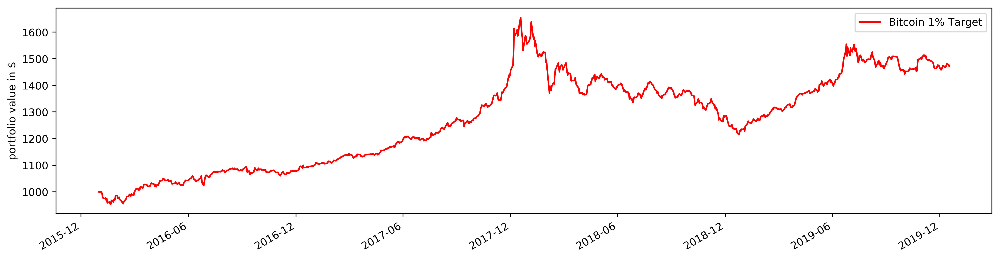

Bitcoin 1%: 47.08%


In [47]:
fig, ax = plt.subplots(figsize=[16, 4])

# portfolio value
bitcoinPortfolio.plot(color='r')
#portfolio1.plot(color='gold')
#vanguard.plot(color='gray')

ax.set_ylabel('portfolio value in $')

plt.legend()
plt.show()

print('Bitcoin 1%: {}%'.format(RETURN[0]))

In [48]:
#Поправляем индексацию

new_index = pd.Series(pd.to_datetime(positions.index).date).map(lambda x: x.strftime('%Y-%m-%d'))
weights_df = pd.DataFrame.from_records(positions, index=new_index)
weights_df.head()

sid,Equity(0 [VPGDX]),Equity(1 [BTC]),cash
2016-01-04,9.791449e+06,100477.112793,96200.038036
2016-01-05,9.797164e+06,100214.718018,96200.038036
2016-01-06,9.740037e+06,99552.362549,96200.038036
2016-01-07,9.614360e+06,106267.136963,96200.038036
2016-01-08,9.557234e+06,105149.362549,96200.038036


In [49]:
# Поправляем названия столбцов

weights_df.columns = ['BTC', 'VPGDX', 'Cash']

In [50]:
# Нормирование весов в файле

norm_weights_df = weights_df.copy()

norm_weights_df['BTC'] = weights_df['BTC']/(weights_df['BTC'] + weights_df['VPGDX'] + weights_df['Cash'])    
norm_weights_df['VPGDX'] = weights_df['VPGDX']/(weights_df['VPGDX'] + weights_df['BTC'] + weights_df['Cash'])
norm_weights_df['Cash'] = weights_df['Cash']/(weights_df['VPGDX'] + weights_df['BTC'] + weights_df['Cash'])

In [51]:
# convert date objects from pandas format to python datetime
norm_weights_df.index = [pd.to_datetime(date, format='%Y-%m-%d').date() for date in norm_weights_df.index]

In [52]:
norm_weights_df.tail()

,BTC,VPGDX,Cash
2019-12-11,0.879541,0.113914,0.006545
2019-12-12,0.879554,0.113924,0.006522
2019-12-13,0.879555,0.113945,0.006499
2019-12-16,0.884641,0.108848,0.006511
2019-12-17,0.888715,0.104744,0.006541


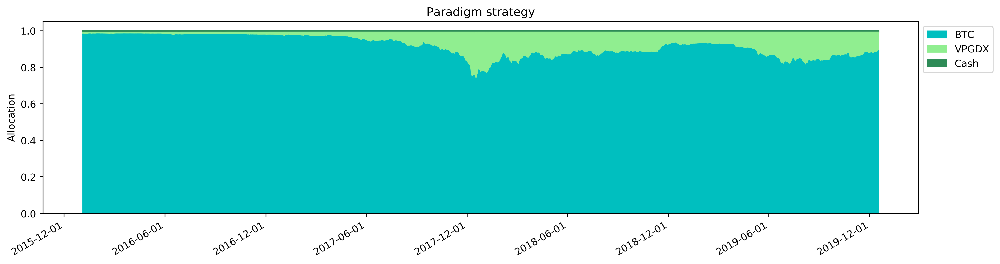

In [53]:
norm_weights_df = norm_weights_df[['BTC', 'VPGDX', 'Cash']]
# plot the results
col = ['c', 'lightgreen', 'seagreen']
ax = norm_weights_df.plot(kind='area', stacked=True, color = col) # stacked=True показывает веса в одном столбце

# set monthly locator

##### Градуировка https://matplotlib.org/3.1.0/gallery/ticks_and_spines/tick-locators.html
#ax.xaxis.set_major_locator(mdates.MonthLocator(interval=6))
# set formatter
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
# set font and rotation for date tick labels
plt.gcf().autofmt_xdate()

ax.tick_params(axis = 'both', direction = 'out')
ax.set(title = 'Paradigm strategy', ylabel='Allocation')
ax.legend(bbox_to_anchor=(1,1))
plt.show()

# Симуляция с 1% Paradigm

In [54]:
# Список финансовых инструментов в портфеле
TIKERS = ['VPGDX', 'BTC']

# Данные которые будут использоваться в дальнейшем
COLUMNS = ['open', 'close', 'adjclose']

In [55]:
data = OrderedDict()

for tiker in TIKERS:
    data[tiker] = pd.read_csv("data/{}.csv".format(tiker), index_col=0, parse_dates=['date'])
    data[tiker] = data[tiker][COLUMNS]
    data[tiker] = data[tiker].resample("1d").mean()
    data[tiker].fillna(method="ffill", inplace=True)
    print(data[tiker].head())

                 open      close   adjclose
date                                       
2015-12-31  17.330000  17.330000  12.789925
2016-01-01  17.330000  17.330000  12.789925
2016-01-02  17.330000  17.330000  12.789925
2016-01-03  17.330000  17.330000  12.789925
2016-01-04  17.139999  17.139999  12.649699
                  open       close    adjclose
date                                          
2015-12-31  425.875000  430.566986  430.566986
2016-01-01  430.721008  434.334015  434.334015
2016-01-02  434.622009  433.437988  433.437988
2016-01-03  433.578003  430.010986  430.010986
2016-01-04  430.061005  433.091003  433.091003


In [56]:
for tiker in TIKERS:
    data[tiker]['close'] = data[tiker]['adjclose']
    data[tiker]['open'] = data[tiker]['adjclose']
    del data[tiker]['adjclose']
    print(data[tiker].tail())
COLUMNS = ['open', 'close']

                 open      close
date                            
2019-12-12  16.760828  16.760828
2019-12-13  16.819126  16.819126
2019-12-14  16.819126  16.819126
2019-12-15  16.819126  16.819126
2019-12-16  16.887140  16.887140
                   open        close
date                                
2019-12-13  7269.684570  7269.684570
2019-12-14  7124.673828  7124.673828
2019-12-15  7152.301758  7152.301758
2019-12-16  6932.480469  6932.480469
2019-12-17  6640.515137  6640.515137


In [57]:
data['BTC']['close'] = paradigm.close.values
data['BTC']['open'] = paradigm.close.values

In [58]:
panel = pd.Panel(data)
panel.minor_axis = COLUMNS
panel.major_axis = panel.major_axis.tz_localize(pytz.utc)
print(panel)

<class 'pandas.core.panel.Panel'>
Dimensions: 2 (items) x 1448 (major_axis) x 2 (minor_axis)
Items axis: VPGDX to BTC
Major_axis axis: 2015-12-31 00:00:00+00:00 to 2019-12-17 00:00:00+00:00
Minor_axis axis: open to close


In [59]:
WEIGHTS = [0.99, 0.01]
COMMISSION = 0.0007

In [60]:
def initialize(context):
    
    context.set_commission(commission.PerDollar(cost=COMMISSION))
    
    set_benchmark(symbol('VPGDX'))
    
    context.tikers = TIKERS
    context.assets = [context.symbol(symbol) for symbol in context.tikers]
    
    context.weights = WEIGHTS
    context.n_assets = len(context.assets)
    
    context.window = 1
    
    context.rebalance_period = 1000000
    context.time = 0

In [61]:
def handle_data(context, data):
    
    # Закупка и ребаллансировка
    if context.time == 0 or (context.time % context.rebalance_period == 0):
        
        
        # submit orders
        for i, asset in enumerate(context.assets):
            order_target_percent(asset, context.weights[i])
            
    
    context.time += 1

In [62]:
perf = zipline.run_algorithm(start=datetime(2015, 12, 31, 0, 0, 0, 0, pytz.utc),
                              end=datetime(2019, 12, 17, 0, 0, 0, 0, pytz.utc),
                              initialize=initialize,
                              capital_base=10000000,
                              handle_data=handle_data,
                              data=panel)

In [63]:
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(perf)

In [64]:
pf.create_simple_tear_sheet(returns, positions, transactions, live_start_date='2018-01-01')

Start date,2015-12-31
End date,2019-12-17
Total months,47
,Backtest
Annual return,12.0%
Cumulative returns,56.6%
Annual volatility,12.7%
Sharpe ratio,0.96
Calmar ratio,0.42
Stability,0.73
Max drawdown,-28.5%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,28.47,2018-01-05,2018-12-21,NaT,NaN
1,7.80,2017-12-18,2017-12-22,2018-01-05,15
2,4.61,2015-12-31,2016-01-20,2016-03-01,44
3,4.59,2017-08-31,2017-09-13,2017-10-10,29
4,3.68,2017-06-12,2017-07-10,2017-08-04,40


Stress Events,mean,min,max
New Normal,0.05%,-5.82%,5.26%


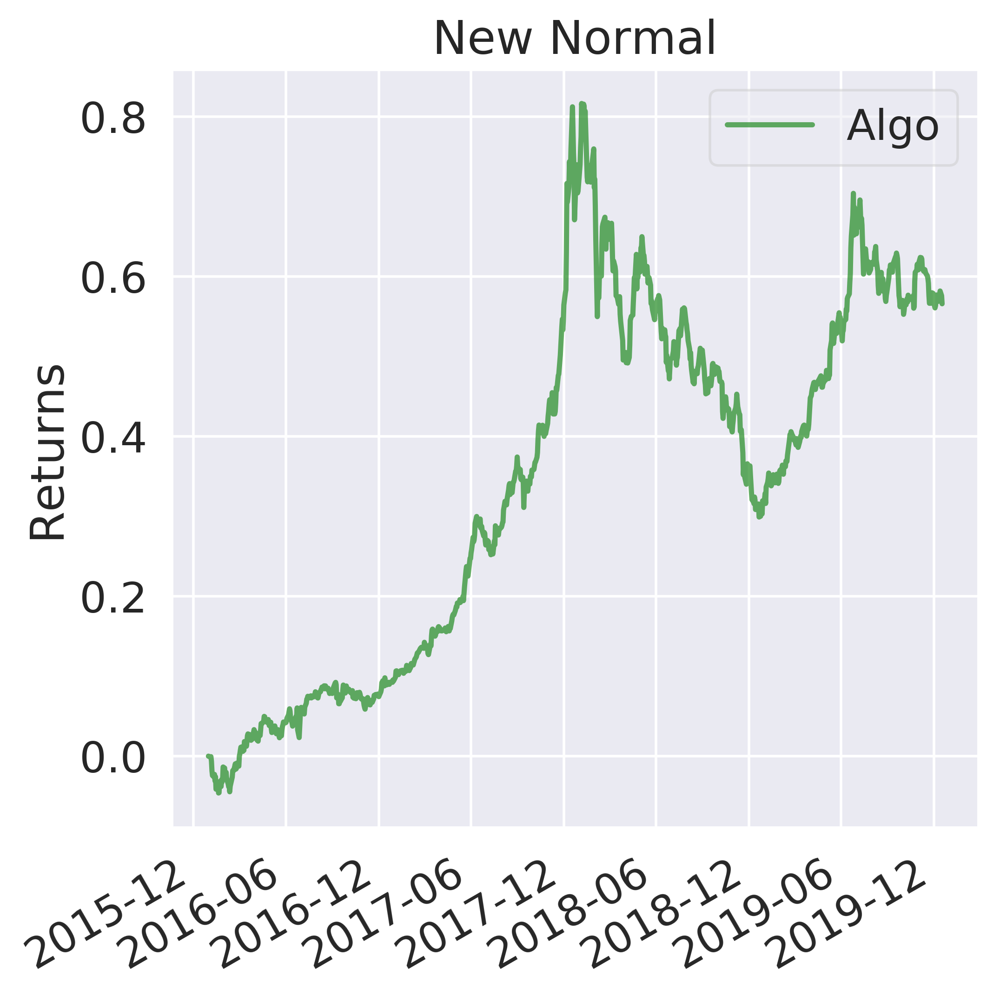

In [65]:
pf.create_full_tear_sheet(returns)

In [66]:
qf.get_performance_summary(returns)

annual_volatility     0.126571
annualized_returns    0.119876
cumulative_returns    0.565769
max_drawdown         -0.284741
sharpe_ratio          0.958067
sortino_ratio         1.357629
dtype: float64

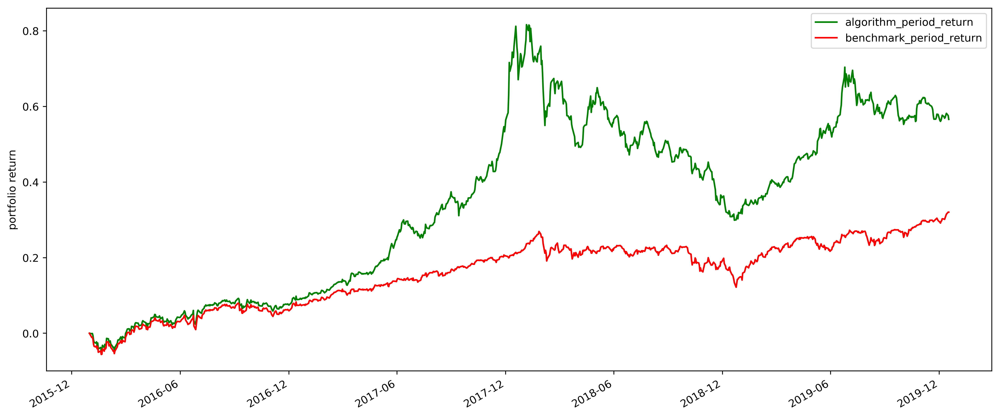

Final portfolio return: 56.58%
Final benchmark return: 32.03%


In [67]:
fig, ax = plt.subplots(figsize=[16, 7])

# portfolio value
perf.algorithm_period_return.plot(color='g')
perf.benchmark_period_return.plot(color='r')

ax.set_ylabel('portfolio return')

plt.legend()
plt.show()

print('Final portfolio return: {}%'.format(np.round(perf.algorithm_period_return[-1] * 100, 2)))
print('Final benchmark return: {}%'.format(np.round(perf.benchmark_period_return[-1] * 100, 2)))

In [68]:
paradigm1 = perf.algorithm_period_return

In [69]:
vanguard = perf.benchmark_period_return

In [70]:
RETURN.append(np.round(paradigm1[-1] * 100, 2))
RETURN.append(np.round(vanguard[-1] * 100, 2))

In [71]:
paradigmPortfolio = 1000 * (1 + paradigm1)
benchmark = 1000 * (1 + vanguard)

paradigmPortfolio = paradigmPortfolio.rename('Paradigm 1% Target')
benchmark = benchmark.rename('VPGDX') 

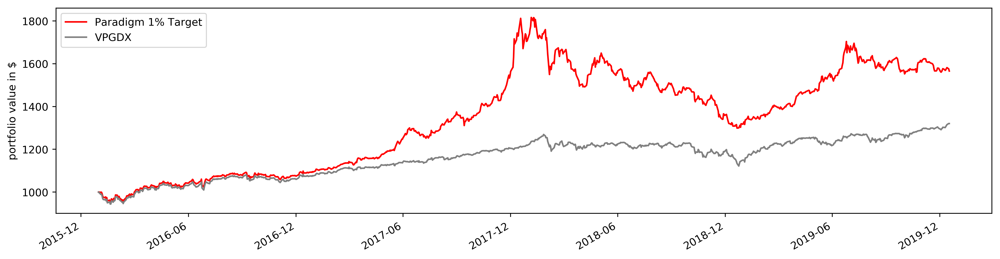

Paradigm 1%: 56.58%
VPGDX: 32.03%


In [72]:
fig, ax = plt.subplots(figsize=[16, 4])

# portfolio value
paradigmPortfolio.plot(color='r')
benchmark.plot(color='gray')

ax.set_ylabel('portfolio value in $')

plt.legend()
plt.show()

print('Paradigm 1%: {}%'.format(RETURN[1]))
print('VPGDX: {}%'.format(RETURN[2]))

In [73]:
#Поправляем индексацию

new_index = pd.Series(pd.to_datetime(positions.index).date).map(lambda x: x.strftime('%Y-%m-%d'))
weights_df = pd.DataFrame.from_records(positions, index=new_index)
weights_df.tail()

sid,Equity(0 [VPGDX]),Equity(1 [BTC]),cash
2019-12-11,1.292852e+07,2.685921e+06,97005.935917
2019-12-12,1.297365e+07,2.699010e+06,97005.935917
2019-12-13,1.301878e+07,2.701425e+06,97005.935917
2019-12-16,1.307142e+07,2.590342e+06,97005.935917
2019-12-17,1.307142e+07,2.489266e+06,97005.935917


In [74]:
# Поправляем названия столбцов

weights_df.columns = ['Paradigm', 'VPGDX', 'Cash']

In [75]:
# Нормирование весов в файле

norm_weights_df = weights_df.copy()

norm_weights_df['Paradigm'] = weights_df['Paradigm']/(weights_df['Paradigm'] + weights_df['VPGDX'] + weights_df['Cash'])    
norm_weights_df['VPGDX'] = weights_df['VPGDX']/(weights_df['VPGDX'] + weights_df['Paradigm'] + weights_df['Cash'])
norm_weights_df['Cash'] = weights_df['Cash']/(weights_df['VPGDX'] + weights_df['Paradigm'] + weights_df['Cash'])

In [76]:
# convert date objects from pandas format to python datetime
norm_weights_df.index = [pd.to_datetime(date, format='%Y-%m-%d').date() for date in norm_weights_df.index]

In [77]:
norm_weights_df.tail()

,Paradigm,VPGDX,Cash
2019-12-11,0.822873,0.170953,0.006174
2019-12-12,0.822697,0.171152,0.006151
2019-12-13,0.823077,0.170790,0.006133
2019-12-16,0.829470,0.164375,0.006156
2019-12-17,0.834824,0.158980,0.006195


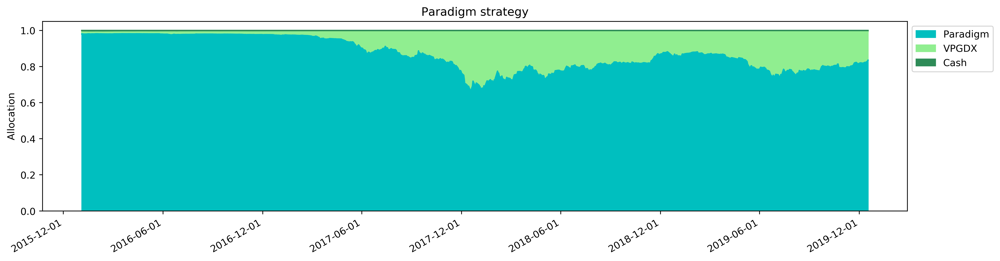

In [78]:
norm_weights_df = norm_weights_df[['Paradigm', 'VPGDX', 'Cash']]
# plot the results
col = ['c', 'lightgreen', 'seagreen']
ax = norm_weights_df.plot(kind='area', stacked=True, color = col) # stacked=True показывает веса в одном столбце

# set monthly locator

##### Градуировка https://matplotlib.org/3.1.0/gallery/ticks_and_spines/tick-locators.html
#ax.xaxis.set_major_locator(mdates.MonthLocator(interval=6))
# set formatter
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
# set font and rotation for date tick labels
plt.gcf().autofmt_xdate()

ax.tick_params(axis = 'both', direction = 'out')
ax.set(title = 'Paradigm strategy', ylabel='Allocation')
ax.legend(bbox_to_anchor=(1,1))
plt.show()

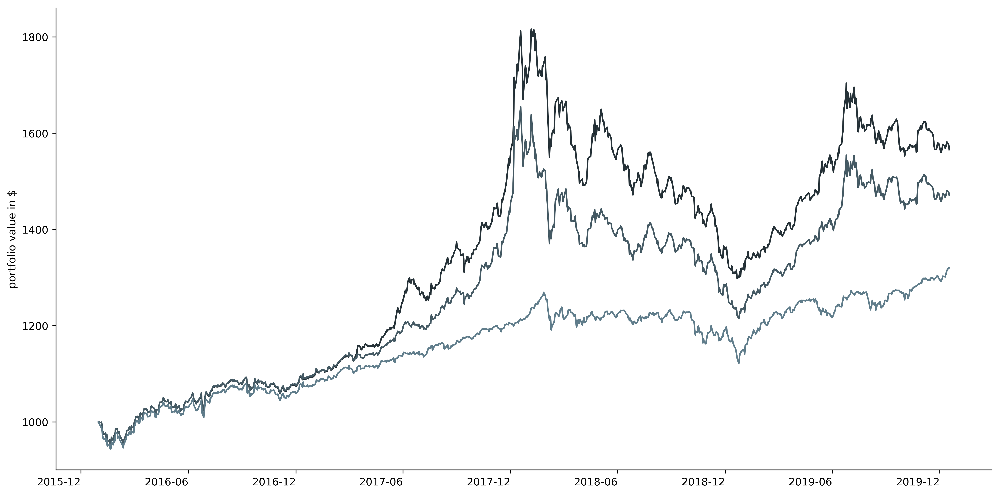

Bitcoin 1%: 47.08%
Paradigm 1%: 56.58%
VPGDX: 32.03%


In [79]:
fig, ax = plt.subplots(figsize=[16, 9])

# portfolio value
paradigmPortfolio.plot(color='#263238')
bitcoinPortfolio.plot(color='#455A64')
benchmark.plot(color='#607D8B')

# Hide the right and top spines
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

plt.xticks(rotation='horizontal')

ax.set_ylabel('portfolio value in $')
#plt.legend(edgecolor = 'w')
plt.show()

print('Bitcoin 1%: {}%'.format(RETURN[0]))
print('Paradigm 1%: {}%'.format(RETURN[1]))
print('VPGDX: {}%'.format(RETURN[2]))

In [175]:
#fig.savefig('stats.png', transparent=True, dpi=1000, bbox_inches="tight")

# Bitcoin 0.5%

In [393]:
# Список финансовых инструментов в портфеле
TIKERS = ['VPGDX', 'BTC']

# Данные которые будут использоваться в дальнейшем
COLUMNS = ['open', 'high', 'low', 'close']

In [193]:
data = OrderedDict()

for tiker in TIKERS:
    data[tiker] = pd.read_csv("data/{}.csv".format(tiker), index_col=0, parse_dates=['date'])
    data[tiker] = data[tiker][COLUMNS]
    data[tiker] = data[tiker].resample("1d").mean()
    data[tiker].fillna(method="ffill", inplace=True)
    print(data[tiker].head())

                 open       high        low      close
date                                                  
2015-12-31  17.330000  17.330000  17.330000  17.330000
2016-01-01  17.330000  17.330000  17.330000  17.330000
2016-01-02  17.330000  17.330000  17.330000  17.330000
2016-01-03  17.330000  17.330000  17.330000  17.330000
2016-01-04  17.139999  17.139999  17.139999  17.139999
                  open        high         low       close
date                                                      
2015-12-31  425.875000  432.920990  418.734985  430.566986
2016-01-01  430.721008  436.246002  427.515015  434.334015
2016-01-02  434.622009  436.062012  431.869995  433.437988
2016-01-03  433.578003  433.743011  424.705994  430.010986
2016-01-04  430.061005  434.516998  429.084015  433.091003


In [194]:
panel = pd.Panel(data)
panel.minor_axis = COLUMNS
panel.major_axis = panel.major_axis.tz_localize(pytz.utc)
print(panel)

<class 'pandas.core.panel.Panel'>
Dimensions: 2 (items) x 1437 (major_axis) x 4 (minor_axis)
Items axis: VPGDX to BTC
Major_axis axis: 2015-12-31 00:00:00+00:00 to 2019-12-06 00:00:00+00:00
Minor_axis axis: open to close


In [195]:
WEIGHTS = [0.995, 0.005]
COMMISSION = 0.0007

In [196]:
def initialize(context):
    
    context.set_commission(commission.PerDollar(cost=COMMISSION))
    
    set_benchmark(symbol('VPGDX'))
    
    context.tikers = TIKERS
    context.assets = [context.symbol(symbol) for symbol in context.tikers]
    
    context.weights = WEIGHTS
    context.n_assets = len(context.assets)
    
    context.window = 1
    
    context.rebalance_period = 1000000
    context.time = 0

In [197]:
def handle_data(context, data):
    
    # Закупка и ребаллансировка
    if context.time == 0 or (context.time % context.rebalance_period == 0):
        
        
        # submit orders
        for i, asset in enumerate(context.assets):
            order_target_percent(asset, context.weights[i])
            
    
    context.time += 1

In [198]:
perf = zipline.run_algorithm(start=datetime(2015, 12, 31, 0, 0, 0, 0, pytz.utc),
                              end=datetime(2019, 12, 6, 0, 0, 0, 0, pytz.utc),
                              initialize=initialize,
                              capital_base=10000000,
                              handle_data=handle_data,
                              data=panel)

In [199]:
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(perf)

In [200]:
qf.get_performance_summary(returns)

annual_volatility     0.097208
annualized_returns    0.019236
cumulative_returns    0.077889
max_drawdown         -0.285250
sharpe_ratio          0.245218
sortino_ratio         0.314484
dtype: float64

In [201]:
bitcoin05 = perf.algorithm_period_return

In [202]:
bitcoinPortfolio05 = 1000 * (1 + bitcoin05)

bitcoinPortfolio05 = bitcoinPortfolio05.rename('Bitcoin 0.5% Target') 

# 0.5% Paradigm

In [203]:
# Список финансовых инструментов в портфеле
TIKERS = ['VPGDX', 'BTC']

# Данные которые будут использоваться в дальнейшем
COLUMNS = ['open', 'close']

In [204]:
data = OrderedDict()

for tiker in TIKERS:
    data[tiker] = pd.read_csv("data/{}.csv".format(tiker), index_col=0, parse_dates=['date'])
    data[tiker] = data[tiker][COLUMNS]
    data[tiker] = data[tiker].resample("1d").mean()
    data[tiker].fillna(method="ffill", inplace=True)
    print(data[tiker].head())

                 open      close
date                            
2015-12-31  17.330000  17.330000
2016-01-01  17.330000  17.330000
2016-01-02  17.330000  17.330000
2016-01-03  17.330000  17.330000
2016-01-04  17.139999  17.139999
                  open       close
date                              
2015-12-31  425.875000  430.566986
2016-01-01  430.721008  434.334015
2016-01-02  434.622009  433.437988
2016-01-03  433.578003  430.010986
2016-01-04  430.061005  433.091003


In [205]:
data['BTC']['close'] = paradigm.close.values
data['BTC']['open'] = paradigm.close.values

In [206]:
panel = pd.Panel(data)
panel.minor_axis = COLUMNS
panel.major_axis = panel.major_axis.tz_localize(pytz.utc)
print(panel)

<class 'pandas.core.panel.Panel'>
Dimensions: 2 (items) x 1437 (major_axis) x 2 (minor_axis)
Items axis: VPGDX to BTC
Major_axis axis: 2015-12-31 00:00:00+00:00 to 2019-12-06 00:00:00+00:00
Minor_axis axis: open to close


In [207]:
WEIGHTS = [0.995, 0.005]
COMMISSION = 0.0007

In [208]:
def initialize(context):
    
    context.set_commission(commission.PerDollar(cost=COMMISSION))
    
    set_benchmark(symbol('VPGDX'))
    
    context.tikers = TIKERS
    context.assets = [context.symbol(symbol) for symbol in context.tikers]
    
    context.weights = WEIGHTS
    context.n_assets = len(context.assets)
    
    context.window = 1
    
    context.rebalance_period = 1000000
    context.time = 0

In [209]:
def handle_data(context, data):
    
    # Закупка и ребаллансировка
    if context.time == 0 or (context.time % context.rebalance_period == 0):
        
        
        # submit orders
        for i, asset in enumerate(context.assets):
            order_target_percent(asset, context.weights[i])
            
    
    context.time += 1

In [210]:
perf = zipline.run_algorithm(start=datetime(2015, 12, 31, 0, 0, 0, 0, pytz.utc),
                              end=datetime(2019, 12, 6, 0, 0, 0, 0, pytz.utc),
                              initialize=initialize,
                              capital_base=10000000,
                              handle_data=handle_data,
                              data=panel)

In [211]:
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(perf)

In [212]:
qf.get_performance_summary(returns)

annual_volatility     0.103741
annualized_returns    0.031300
cumulative_returns    0.128989
max_drawdown         -0.299093
sharpe_ratio          0.349469
sortino_ratio         0.453459
dtype: float64

In [213]:
paradigm05 = perf.algorithm_period_return

In [214]:
paradigmPortfolio05 = 1000 * (1 + paradigm05)
paradigmPortfolio05 = paradigmPortfolio05.rename('Paradigm 0.5% Target')

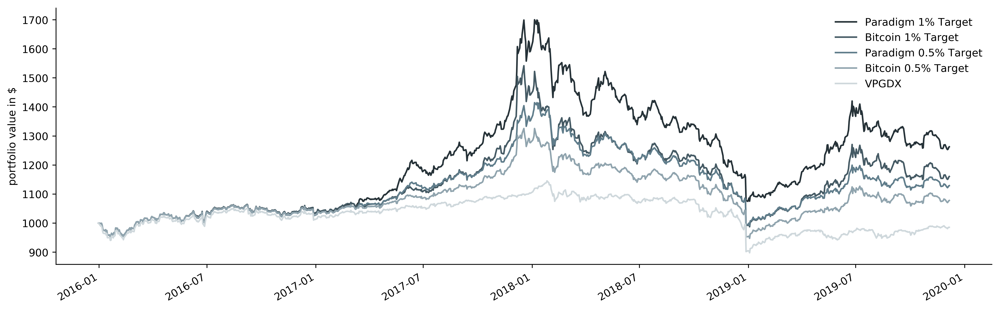

In [215]:
fig, ax = plt.subplots(figsize=[16, 5])

# portfolio value
paradigmPortfolio.plot(color='#263238')
bitcoinPortfolio.plot(color='#455A64')
paradigmPortfolio05.plot(color='#607D8B')
bitcoinPortfolio05.plot(color='#90A4AE')
benchmark.plot(color='#CFD8DC')

# Hide the right and top spines
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

ax.set_ylabel('portfolio value in $')

# https://pyprog.pro/mpl/mpl_adding_a_legend.html
plt.legend(edgecolor = 'w')     
plt.show()

In [216]:
#fig.savefig('stats5.png', transparent=True, dpi=1000, bbox_inches="tight")

# Просадки

In [217]:
window = 365

In [218]:
# Calculate the max drawdown in the past window days for each day in the series.
# Use min_periods=1 if you want to let the first 365 days data have an expanding window
Roll_Max1 = pd.rolling_max(paradigmPortfolio, window, min_periods=1)
Roll_Max2 = pd.rolling_max(bitcoinPortfolio, window, min_periods=1)
Daily_Drawdown1 = paradigmPortfolio/Roll_Max1 - 1.0
Daily_Drawdown2 = bitcoinPortfolio/Roll_Max2 - 1.0

In [219]:
# Next we calculate the minimum (negative) daily drawdown in that window.
# Again, use min_periods=1 if you want to allow the expanding window
Max_Daily_Drawdown1 = pd.rolling_min(Daily_Drawdown1, window, min_periods=1)
Max_Daily_Drawdown2 = pd.rolling_min(Daily_Drawdown2, window, min_periods=1)

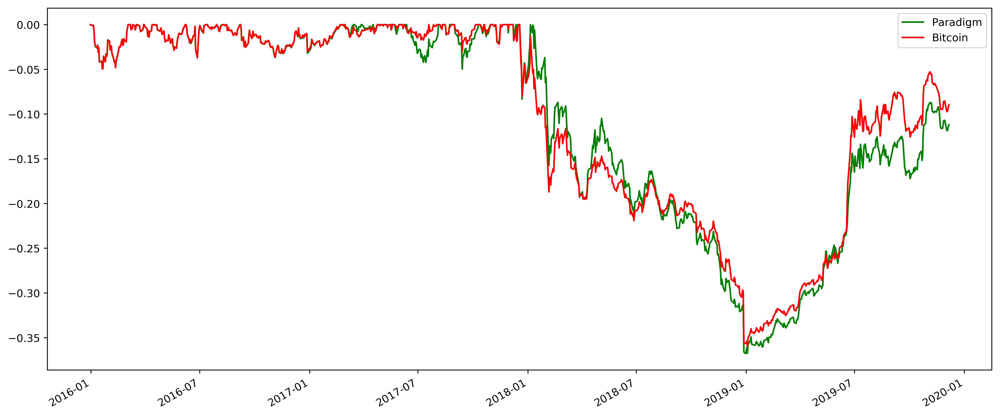

In [220]:
# Plot the results
fig, ax = plt.subplots(figsize=[16, 7])
Daily_Drawdown1.plot(color='g', label='Paradigm')
Daily_Drawdown2.plot(color='r', label='Bitcoin')
plt.legend()
plt.show()

# Просто фонд Vanguard

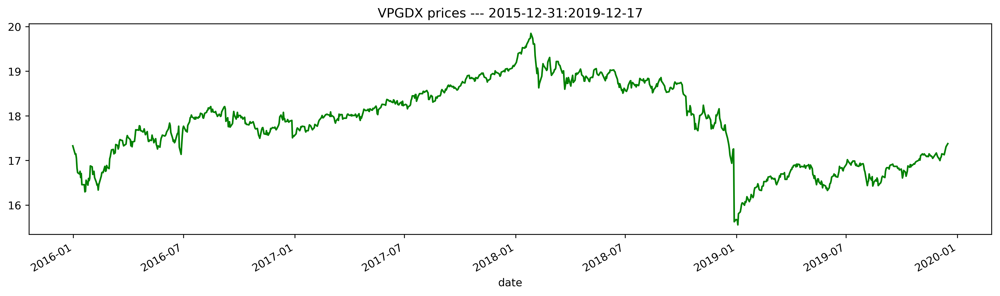

In [449]:
download_csv_data(ticker='VPGDX', 
                  start_date='2015-12-31', 
                  end_date='2019-12-17', 
                  freq='daily', 
                  path='data/VPGDX.csv')

In [456]:
# Список финансовых инструментов в портфеле
TIKERS = ['VPGDX']

# Данные которые будут использоваться в дальнейшем
COLUMNS = ['open', 'close', 'adjclose']

In [457]:
data = OrderedDict()

for tiker in TIKERS:
    data[tiker] = pd.read_csv("data/{}.csv".format(tiker), index_col=0, parse_dates=['date'])
    data[tiker] = data[tiker][COLUMNS]
    data[tiker] = data[tiker].resample("1d").mean()
    data[tiker].fillna(method="ffill", inplace=True)
    print(data[tiker].head())

                 open      close   adjclose
date                                       
2015-12-31  17.330000  17.330000  13.163204
2016-01-01  17.330000  17.330000  13.163204
2016-01-02  17.330000  17.330000  13.163204
2016-01-03  17.330000  17.330000  13.163204
2016-01-04  17.139999  17.139999  13.018887


In [458]:
for tiker in TIKERS:
    data[tiker]['close'] = data[tiker]['adjclose']
    data[tiker]['open'] = data[tiker]['adjclose']
    del data[tiker]['adjclose']
    print(data[tiker].tail())
COLUMNS = ['open', 'close']

                 open      close
date                            
2019-12-12  17.250000  17.250000
2019-12-13  17.309999  17.309999
2019-12-14  17.309999  17.309999
2019-12-15  17.309999  17.309999
2019-12-16  17.379999  17.379999


In [459]:
WEIGHTS = [1]
COMMISSION = 0.0007

In [460]:
def initialize(context):
    
    context.set_commission(commission.PerDollar(cost=COMMISSION))
    
    context.tikers = TIKERS
    context.assets = [context.symbol(symbol) for symbol in context.tikers]
    
    context.weights = WEIGHTS
    context.n_assets = len(context.assets)
    
    context.window = 1
    
    #context.rebalance_period = 1000000
    context.time = 0

In [464]:
def handle_data(context, data):
    
    # Закупка и ребаллансировка
    if context.time == 0 or (context.time % context.rebalance_period == 0):  
        
        # submit orders
        for i, asset in enumerate(context.assets):
            order_target_percent(asset, context.weights[i])
            
    
    context.time += 1

In [465]:
perf = zipline.run_algorithm(start=datetime(2015, 12, 31, 0, 0, 0, 0, pytz.utc),
                              end=datetime(2019, 12, 17, 0, 0, 0, 0, pytz.utc),
                              initialize=initialize,
                              capital_base=10000000,
                              handle_data=handle_data,
                              data=panel)

ValueError: cannot reindex from a duplicate axis

In [402]:
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(perf)

In [185]:
qf.get_performance_summary(returns)

annual_volatility     0.067260
annualized_returns    0.073680
cumulative_returns    0.324806
max_drawdown         -0.115337
sharpe_ratio          1.090763
sortino_ratio         1.530601
dtype: float64